In [1]:
# 🎨 GAN Art Generator Colab Notebook


In [16]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
import os
DATA_DIR = "/content/drive/MyDrive/GAN_ART_GENERATOR/InputData"
OUTPUT_DIR = "/content/drive/MyDrive/GAN_ART_GENERATOR/Outputs3"
os.makedirs(OUTPUT_DIR, exist_ok=True)

In [18]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.utils.data import DataLoader
import numpy as np
import matplotlib.pyplot as plt
import os
import re
from PIL import Image

In [20]:
def get_last_epoch(output_dir):
    files = os.listdir(output_dir)
    epoch_nums = []

    for fname in files:
        match = re.search(r"fake_samples_epoch_(\d+).png", fname)
        if match:
            epoch_nums.append(int(match.group(1)))

    if epoch_nums:
        return max(epoch_nums)
    else:
        return 0  # If no previous epochs found

In [21]:
image_size = 64
batch_size = 128
nz = 100
lr = 0.0002
beta1 = 0.5
last_epoch = get_last_epoch(OUTPUT_DIR)
chunk_size = 25
num_epochs = last_epoch + chunk_size

In [22]:
print(f"Resuming training from epoch {last_epoch+1} to {num_epochs}")

Resuming training from epoch 1 to 25


In [23]:
ngpu = 1
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(f"Using device: {device}")

Using device: cpu


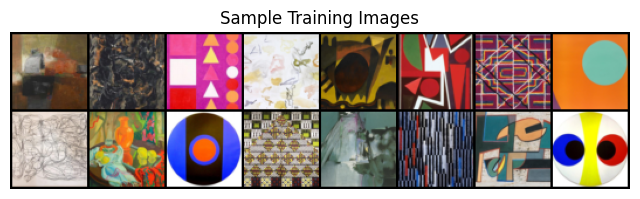

In [24]:
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

dataset = dset.ImageFolder(root=DATA_DIR, transform=transform)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True)

# Get a batch of images
real_batch = next(iter(dataloader))

# Plot the first 16 images
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Sample Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0], padding=2, normalize=True), (1, 2, 0)))
plt.show()


In [25]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


In [26]:
class Generator(nn.Module):
    def __init__(self, nz, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.ConvTranspose2d(nz, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)


In [27]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input).view(-1)



In [28]:


netG = Generator(nz, ngpu).to(device)
netG.apply(weights_init)

netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)



Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

In [29]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.
fake_label = 0.
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

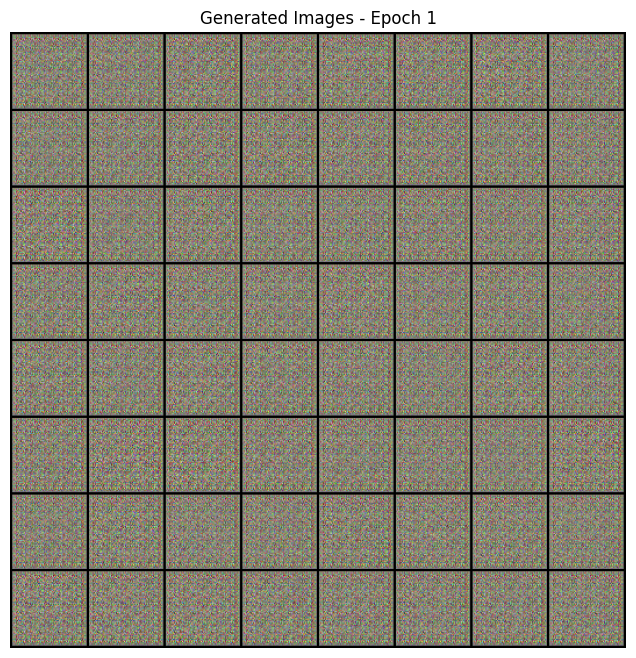

Epoch 1/25 | Loss D: 0.8591 | Loss G: 8.6675


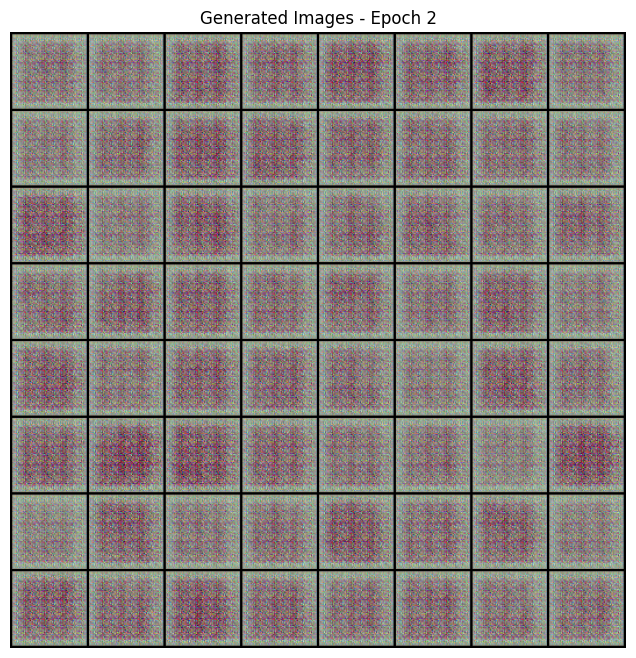

Epoch 2/25 | Loss D: 1.1592 | Loss G: 13.1532


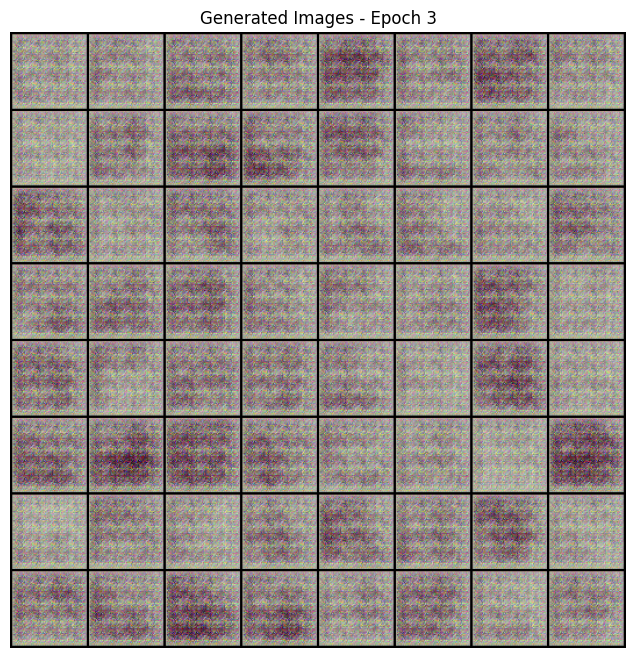

Epoch 3/25 | Loss D: 0.7387 | Loss G: 8.2930


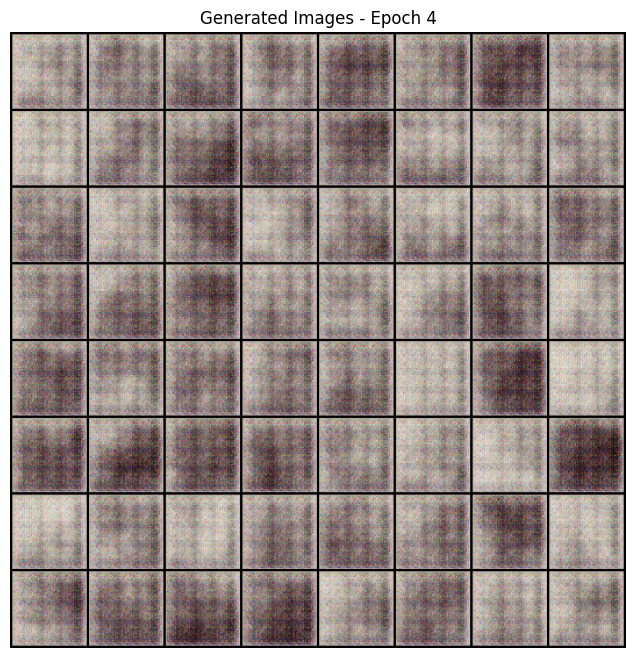

Epoch 4/25 | Loss D: 0.8060 | Loss G: 5.2188


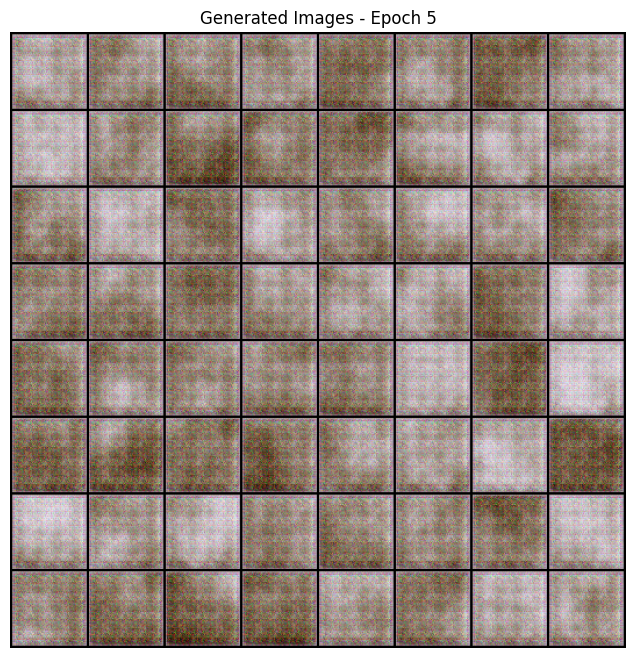

Epoch 5/25 | Loss D: 0.9147 | Loss G: 4.4611


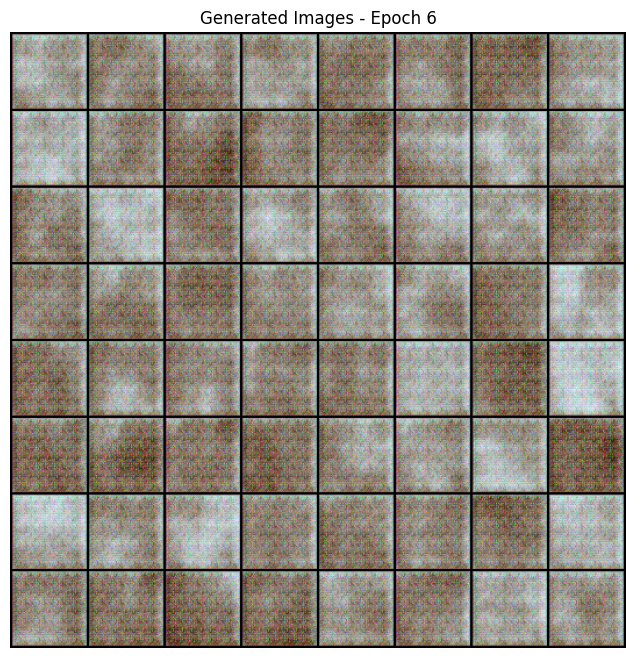

Epoch 6/25 | Loss D: 0.6270 | Loss G: 5.4750


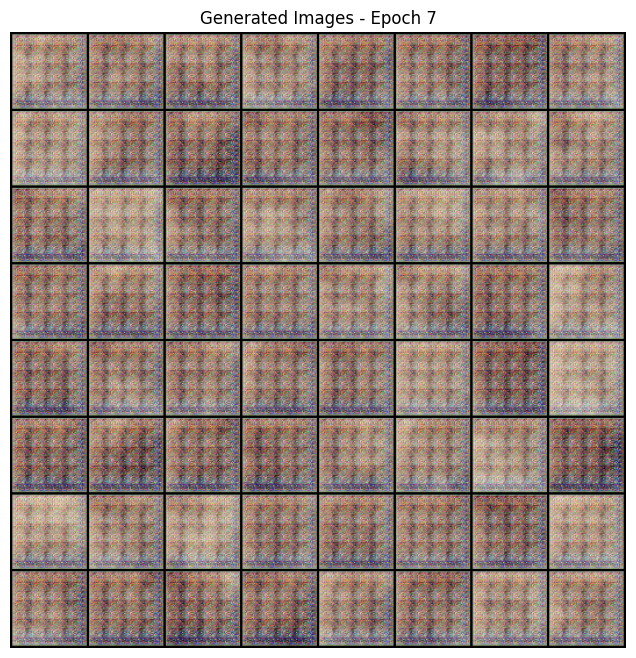

Epoch 7/25 | Loss D: 0.4446 | Loss G: 6.2943


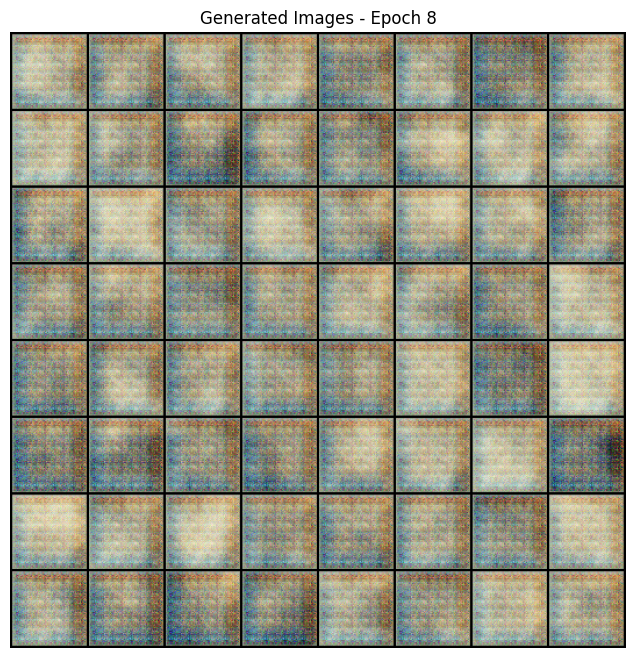

Epoch 8/25 | Loss D: 0.6970 | Loss G: 8.0352


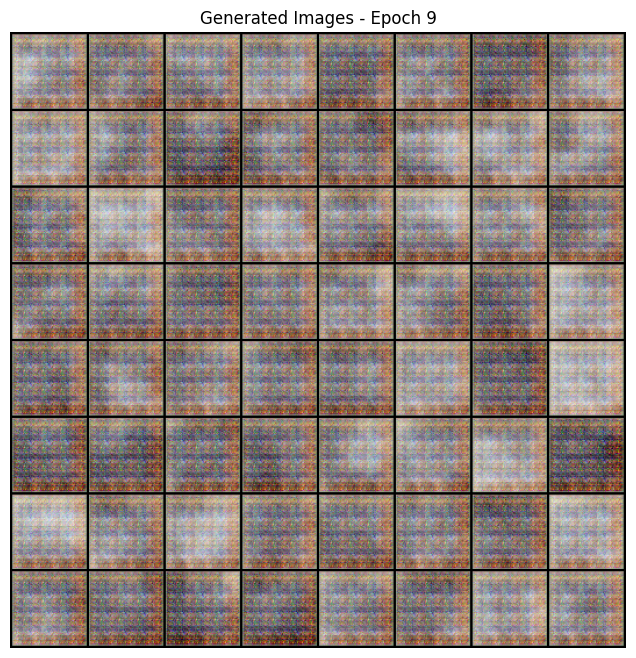

Epoch 9/25 | Loss D: 0.4935 | Loss G: 6.6992


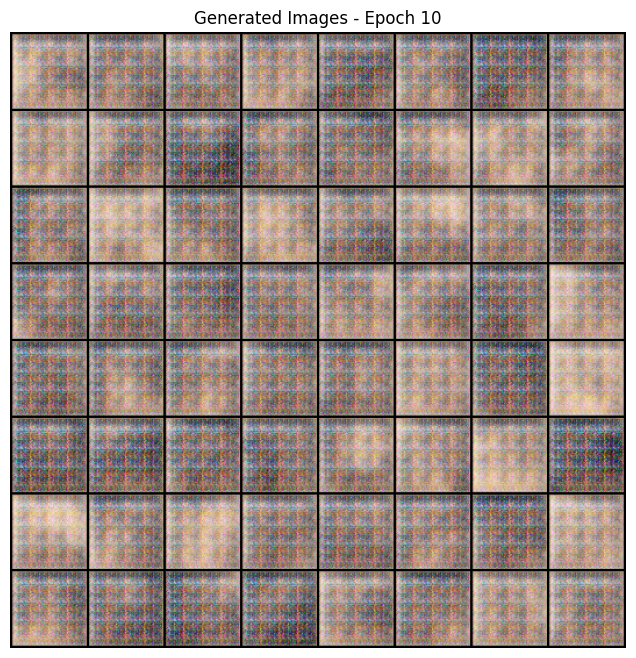

Epoch 10/25 | Loss D: 0.4964 | Loss G: 7.6802


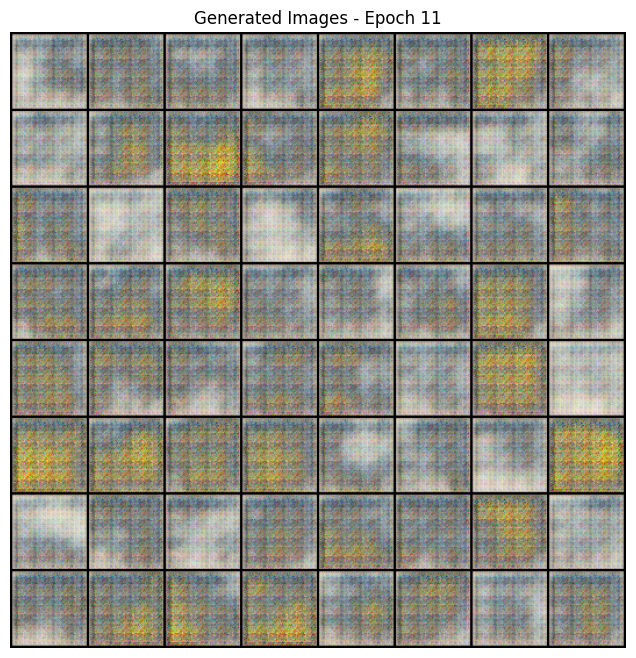

Epoch 11/25 | Loss D: 0.4295 | Loss G: 5.6766


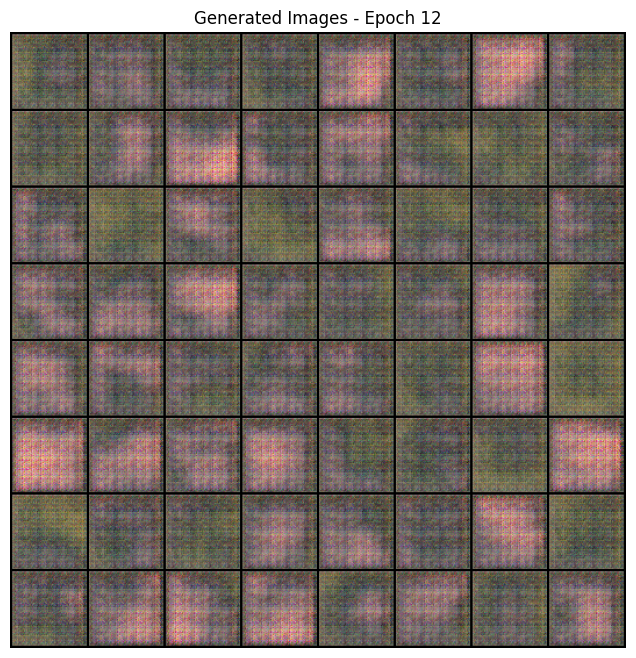

Epoch 12/25 | Loss D: 0.5815 | Loss G: 5.8576


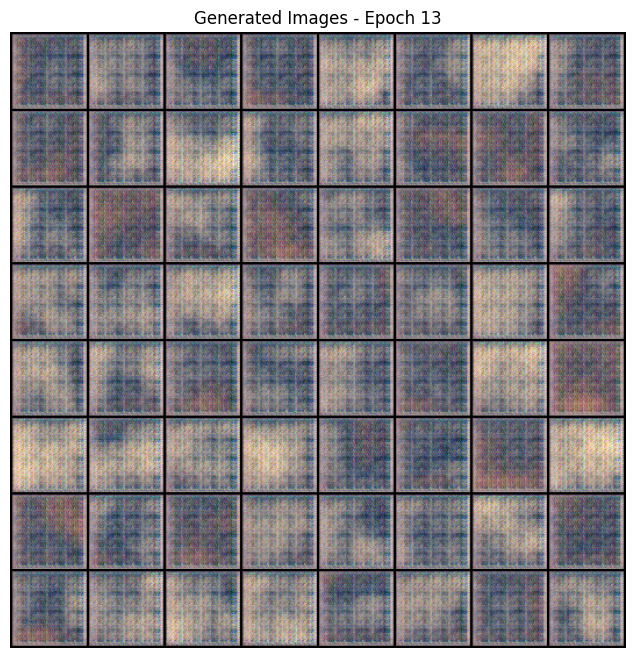

Epoch 13/25 | Loss D: 0.6778 | Loss G: 5.0695


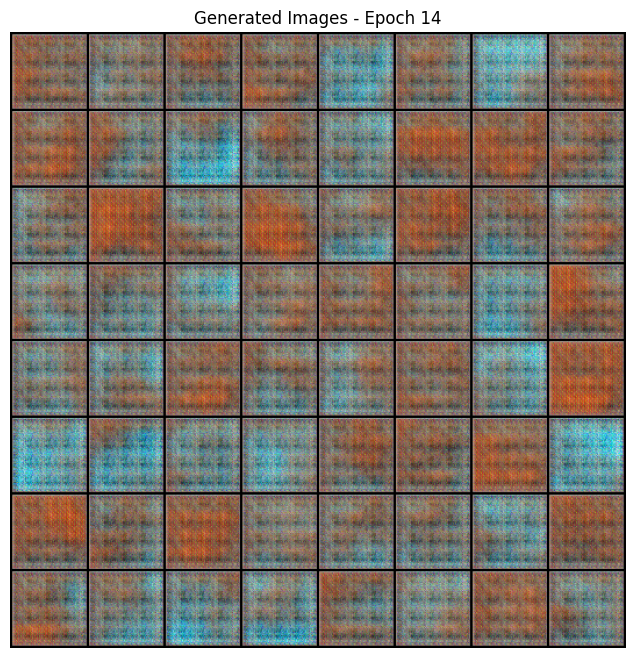

Epoch 14/25 | Loss D: 0.4388 | Loss G: 4.8335


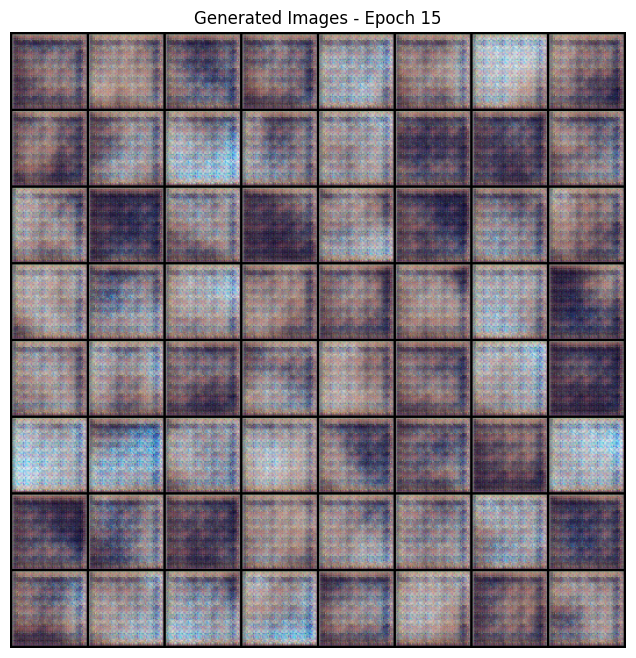

Epoch 15/25 | Loss D: 0.7148 | Loss G: 5.4406


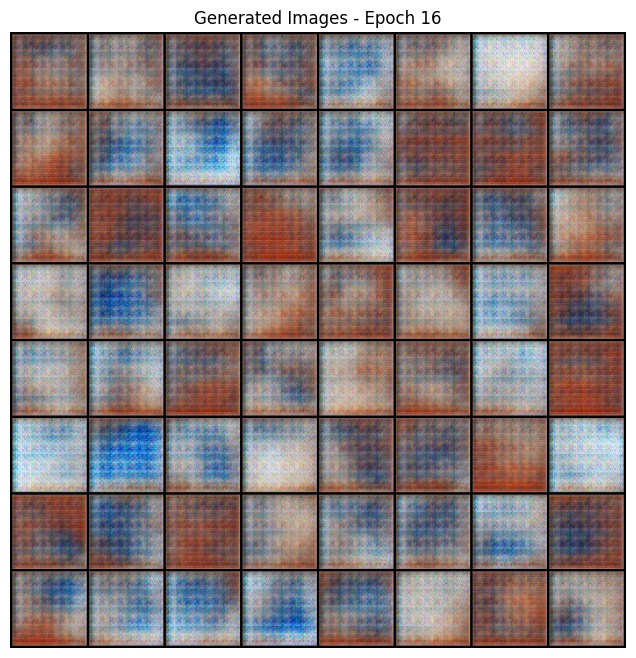

Epoch 16/25 | Loss D: 0.5527 | Loss G: 5.9687


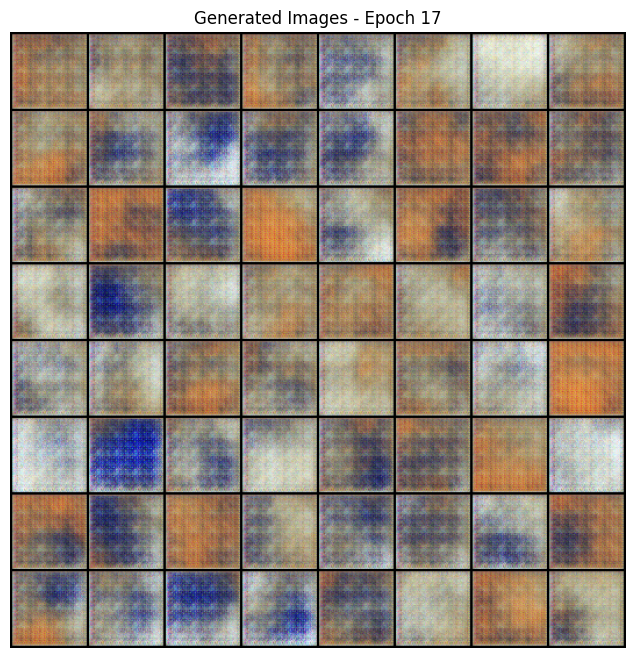

Epoch 17/25 | Loss D: 0.6146 | Loss G: 4.7622


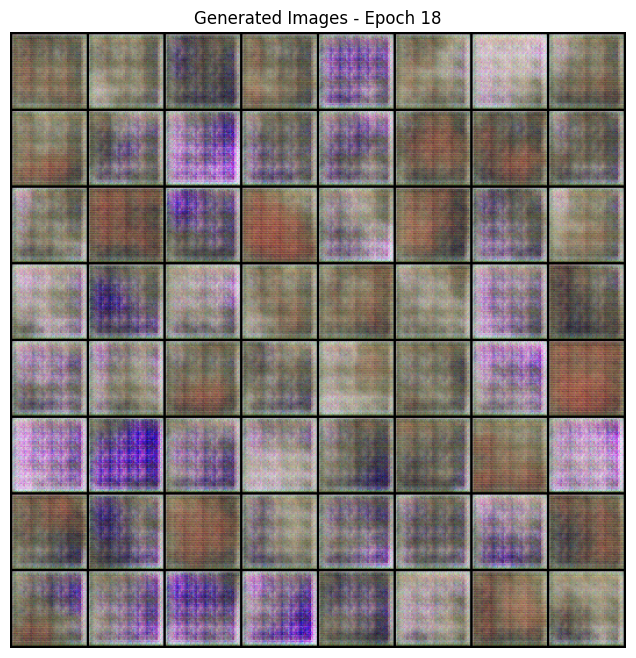

Epoch 18/25 | Loss D: 0.8432 | Loss G: 4.4685


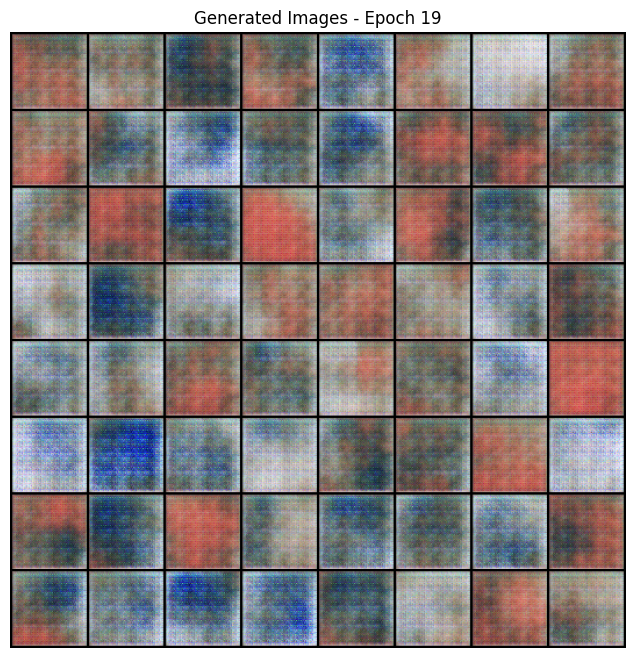

Epoch 19/25 | Loss D: 0.8281 | Loss G: 5.0461


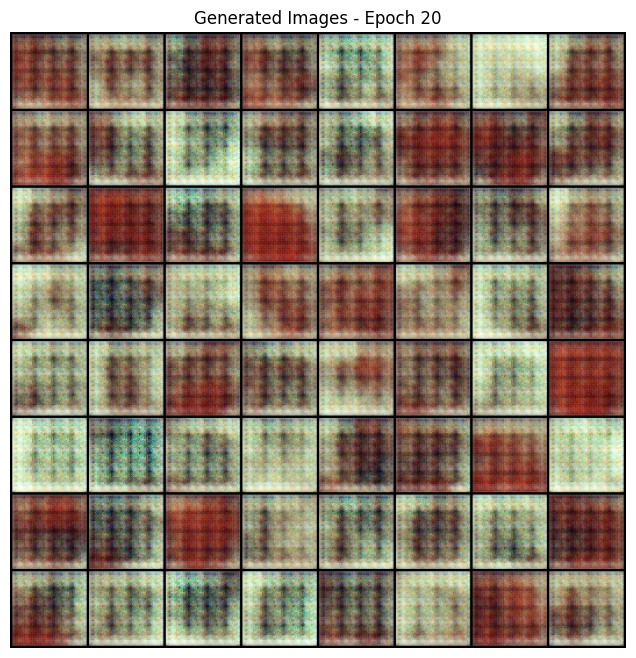

Epoch 20/25 | Loss D: 0.9025 | Loss G: 4.1366


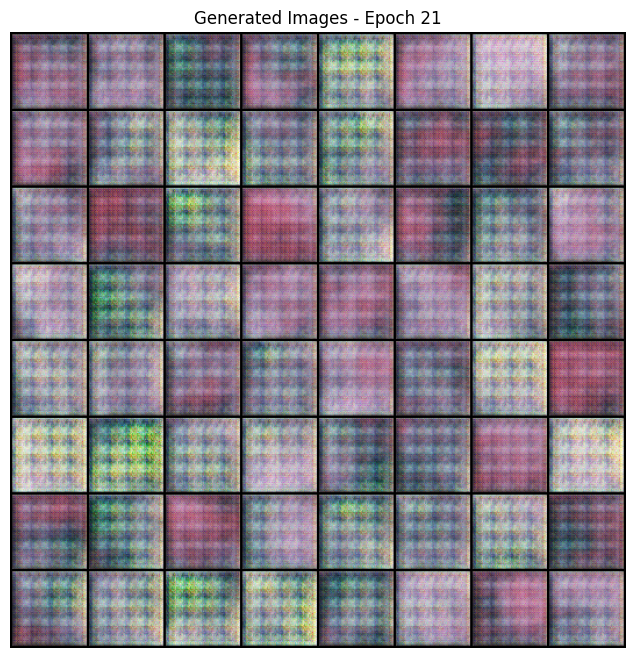

Epoch 21/25 | Loss D: 0.6438 | Loss G: 3.9061


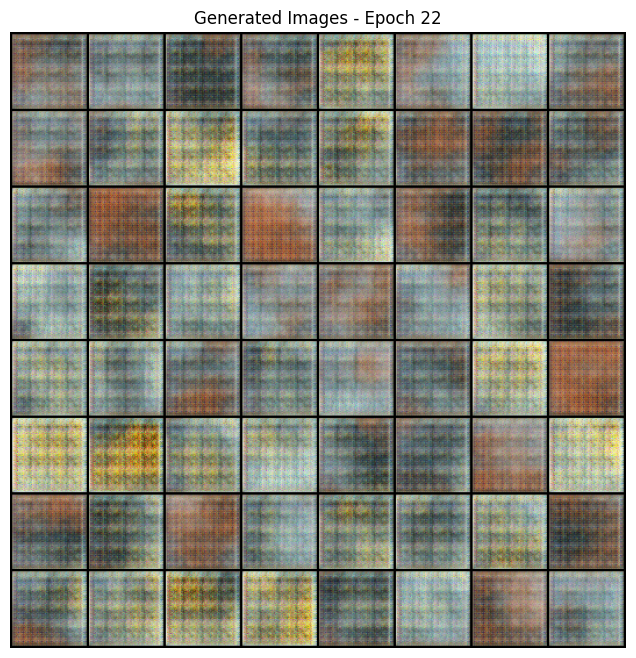

Epoch 22/25 | Loss D: 0.7667 | Loss G: 3.9846


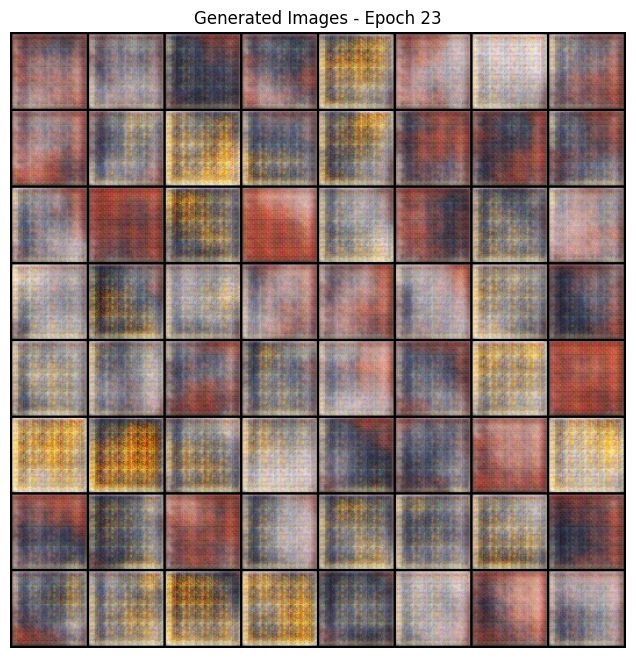

Epoch 23/25 | Loss D: 0.8788 | Loss G: 4.0823


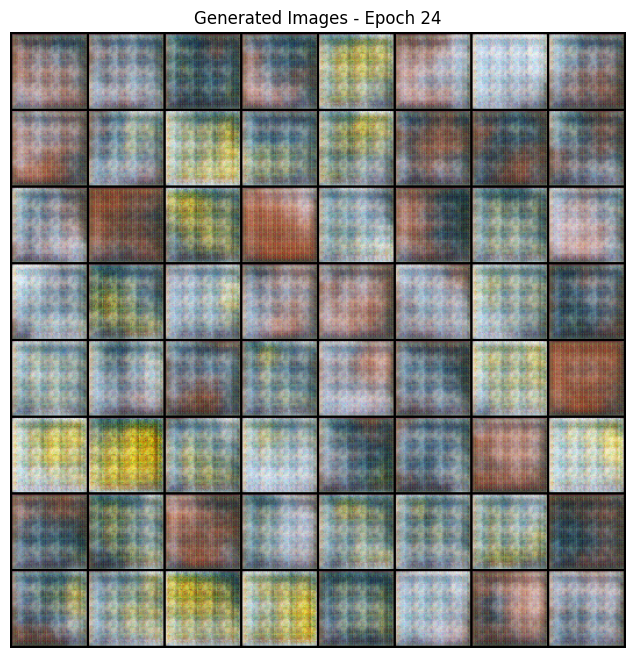

Epoch 24/25 | Loss D: 0.7806 | Loss G: 3.3984


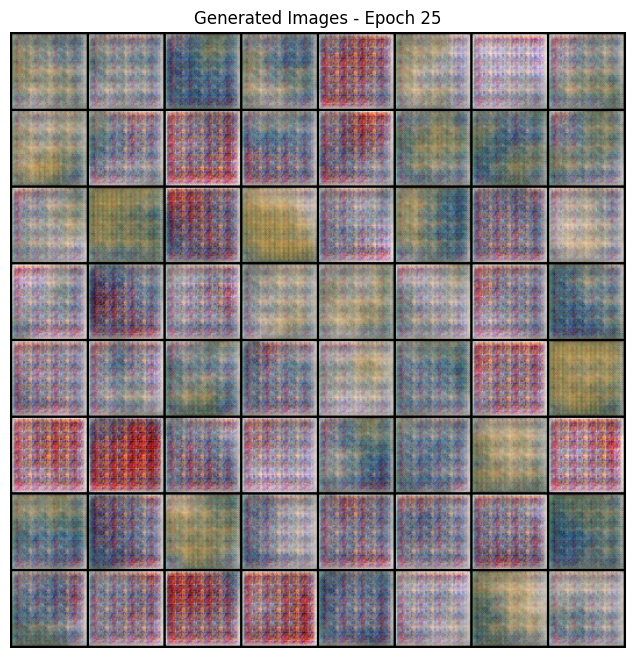

Epoch 25/25 | Loss D: 0.4294 | Loss G: 3.9222


In [30]:
# Training Loop with clean loss print per epoch
for epoch in range(last_epoch, num_epochs):
    lossD_epoch = 0.0
    lossG_epoch = 0.0

    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Train Discriminator
        ############################
        netD.zero_grad()
        real = data[0].to(device)
        b_size = real.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)

        output = netD(real).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)

        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        optimizerD.step()

        errD = errD_real + errD_fake
        lossD_epoch += errD.item()

        ############################
        # (2) Train Generator
        ############################
        netG.zero_grad()
        label.fill_(real_label)
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        optimizerG.step()

        lossG_epoch += errG.item()

    # Save preview images
    # Save preview and show it in Colab
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
        grid = vutils.make_grid(fake, padding=2, normalize=True)
        vutils.save_image(grid, f"{OUTPUT_DIR}/fake_samples_epoch_{epoch:03d}.png")

        # Display the image
        npimg = grid.numpy()
        plt.figure(figsize=(8, 8))
        plt.axis("off")
        plt.title(f"Generated Images - Epoch {epoch+1}")
        plt.imshow(np.transpose(npimg, (1, 2, 0)))
        plt.show()


        # Print epoch summary like your preferred format
        avg_lossD = lossD_epoch / len(dataloader)
        avg_lossG = lossG_epoch / len(dataloader)
        print(f"Epoch {epoch+1}/{num_epochs} | Loss D: {avg_lossD:.4f} | Loss G: {avg_lossG:.4f}")


In [ ]:
    torch.save(netG.state_dict(), f"{OUTPUT_DIR}/generator.pth")
    torch.save(netD.state_dict(), f"{OUTPUT_DIR}/discriminator.pth")

NameError: name 'torch' is not defined